In [1]:
import os, cv2
import numpy as np
import pandas as pd
import random, tqdm
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

import torch
import torch.nn as nn
from torch.utils.data import DataLoader
import albumentations as album

In [2]:
# !pip install torch torchvision --upgrade --user

In [3]:
!pip install segmentation-models-pytorch==0.2.0
import segmentation_models_pytorch as smp
# !pip install torch torchvision --upgrade

     |████████████████████████████████| 87 kB 3.1 MB/s 
     |████████████████████████████████| 376 kB 21.4 MB/s 
     |████████████████████████████████| 58 kB 6.3 MB/s 
  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.6.3-py3-none-any.whl size=12419 sha256=4ef91dde49f88b821f74f019d4f0168bdf33dcf80defe2e6b7936293515c9a65
  Stored in directory: /root/.cache/pip/wheels/90/6b/0c/f0ad36d00310e65390b0d4c9218ae6250ac579c92540c9097a
  Created wheel for pretrainedmodels: filename=pretrainedmodels-0.7.4-py3-none-any.whl size=60962 sha256=b1d45cc73e77f048c16def5d98c5d87e9d1de750ba2bcc7e0fe61551dbd18202
  Stored in directory: /root/.cache/pip/wheels/ed/27/e8/9543d42de2740d3544db96aefef63bda3f2c1761b3334f4873
Successfully built efficientnet-pytorch pretrainedmodels
You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.


In [4]:
# !pip install -q -U segmentation-models-pytorch albumentations > /dev/null
# !pip install segmentation-models-pytorch
import segmentation_models_pytorch as smp

In [5]:
DATA_DIR = '/kaggle/input/deepglobe-land-cover-classification-dataset'

metadata_df = pd.read_csv(os.path.join(DATA_DIR, 'metadata.csv'))
metadata_df = metadata_df[metadata_df['split']=='train']
metadata_df = metadata_df[['image_id', 'sat_image_path', 'mask_path']]
metadata_df['sat_image_path'] = metadata_df['sat_image_path'].apply(lambda img_pth: os.path.join(DATA_DIR, img_pth))
metadata_df['mask_path'] = metadata_df['mask_path'].apply(lambda img_pth: os.path.join(DATA_DIR, img_pth))
metadata_df = metadata_df.sample(frac=1).reset_index(drop=True)

# Perform 90/10 split for train / val
valid_df = metadata_df.sample(frac=0.1, random_state=42)
train_df = metadata_df.drop(valid_df.index)
len(train_df), len(valid_df)

(723, 80)

In [6]:
class_dict = pd.read_csv(os.path.join(DATA_DIR, 'class_dict.csv'))

class_names = class_dict['name'].tolist()

class_rgb_values = class_dict[['r','g','b']].values.tolist()
print('Class Names: ', class_names)
print('Class RGB values: ', class_rgb_values)

Class Names:  ['urban_land', 'agriculture_land', 'rangeland', 'forest_land', 'water', 'barren_land', 'unknown']
Class RGB values:  [[0, 255, 255], [255, 255, 0], [255, 0, 255], [0, 255, 0], [0, 0, 255], [255, 255, 255], [0, 0, 0]]


#### Shortlist specific classes to segment

In [7]:
select_classes = ['urban_land', 'agriculture_land', 'rangeland', 'forest_land', 'water', 'barren_land', 'unknown']

select_class_indices = [class_names.index(cls.lower()) for cls in select_classes]
select_class_rgb_values =  np.array(class_rgb_values)[select_class_indices]

print('Class Names: ', class_names)
print('Class RGB values: ', class_rgb_values)

Class Names:  ['urban_land', 'agriculture_land', 'rangeland', 'forest_land', 'water', 'barren_land', 'unknown']
Class RGB values:  [[0, 255, 255], [255, 255, 0], [255, 0, 255], [0, 255, 0], [0, 0, 255], [255, 255, 255], [0, 0, 0]]


### Helper functions for viz. & one-hot encoding/decoding

In [8]:
def visualize(**images):
    n_images = len(images)
    plt.figure(figsize=(20,8))
    for idx, (name, image) in enumerate(images.items()):
        plt.subplot(1, n_images, idx + 1)
        plt.xticks([]); 
        plt.yticks([])
        # get title from the parameter names
        plt.title(name.replace('_',' ').title(), fontsize=20)
        plt.imshow(image)
    plt.show()

# Perform one hot encoding on label
def one_hot_encode(label, label_values):
    semantic_map = []
    for colour in label_values:
        equality = np.equal(label, colour)
        class_map = np.all(equality, axis = -1)
        semantic_map.append(class_map)
    semantic_map = np.stack(semantic_map, axis=-1)

    return semantic_map
    
# Perform reverse one-hot-encoding on labels / preds
def reverse_one_hot(image):
    x = np.argmax(image, axis = -1)
    return x

# Perform colour coding on the reverse-one-hot outputs
def colour_code_segmentation(image, label_values):
    #Colour coded image for segmentation visualization
    colour_codes = np.array(label_values)
    x = colour_codes[image.astype(int)]

    return x

In [9]:
class LandCoverDataset(torch.utils.data.Dataset):
    def __init__(
            self, 
            df,
            class_rgb_values=None, 
            augmentation=None, 
            preprocessing=None,
    ):
        self.image_paths = df['sat_image_path'].tolist()
        self.mask_paths = df['mask_path'].tolist()
        
        self.class_rgb_values = class_rgb_values
        self.augmentation = augmentation
        self.preprocessing = preprocessing
    
    def __getitem__(self, i):
        image = cv2.cvtColor(cv2.imread(self.image_paths[i]), cv2.COLOR_BGR2RGB)
        mask = cv2.cvtColor(cv2.imread(self.mask_paths[i]), cv2.COLOR_BGR2RGB)       
        mask = one_hot_encode(mask, self.class_rgb_values).astype('float')
        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
        if self.preprocessing:
            sample = self.preprocessing(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
            
        return image, mask
        
    def __len__(self):
        # return length of 
        return len(self.image_paths)

#### Visualize Sample Image and Mask 📈

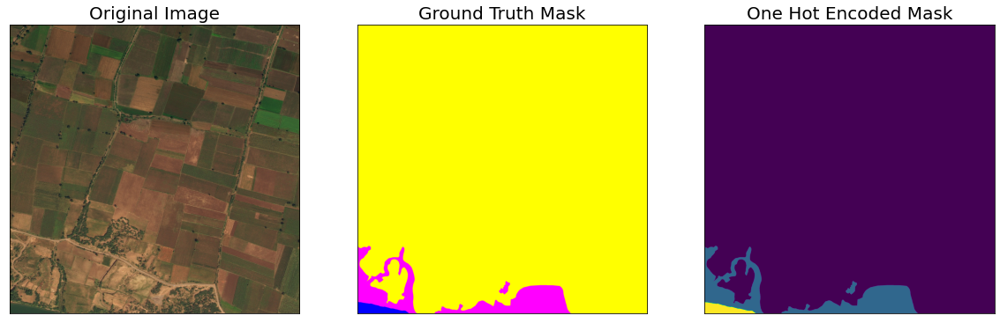

In [10]:
dataset = LandCoverDataset(train_df, class_rgb_values=select_class_rgb_values)
random_idx = random.randint(0, len(dataset)-1)
image, mask = dataset[2]

visualize(
    original_image = image,
    ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
    one_hot_encoded_mask = reverse_one_hot(mask)
)

In [11]:
def get_training_augmentation():
    train_transform = [
        album.RandomCrop(height=1024, width=1024, always_apply=True),
        album.HorizontalFlip(p=0.5),
        album.VerticalFlip(p=0.5),
    ]
    return album.Compose(train_transform)


def get_validation_augmentation():
    train_transform = [
        album.CenterCrop(height=1024, width=1024, always_apply=True),
    ]
    return album.Compose(train_transform)


def to_tensor(x, **kwargs):
    return x.transpose(2, 0, 1).astype('float32')


def get_preprocessing(preprocessing_fn=None):
    _transform = []
    if preprocessing_fn:
        _transform.append(album.Lambda(image=preprocessing_fn))
    _transform.append(album.Lambda(image=to_tensor, mask=to_tensor))
        
    return album.Compose(_transform)

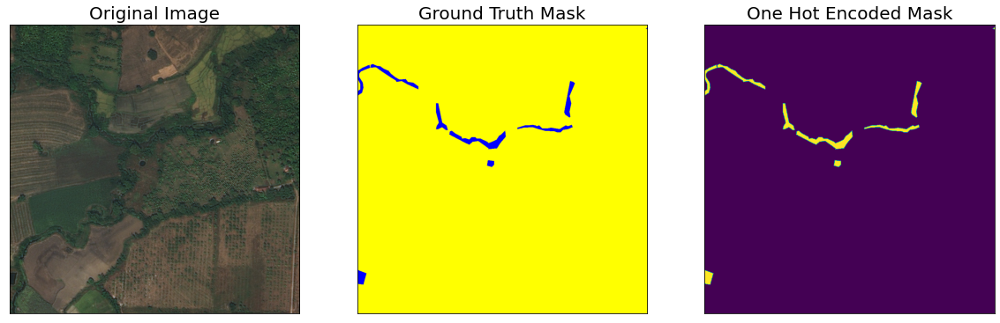

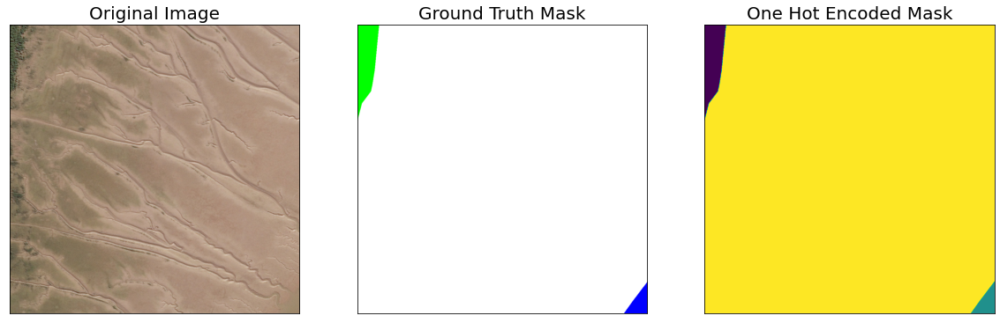

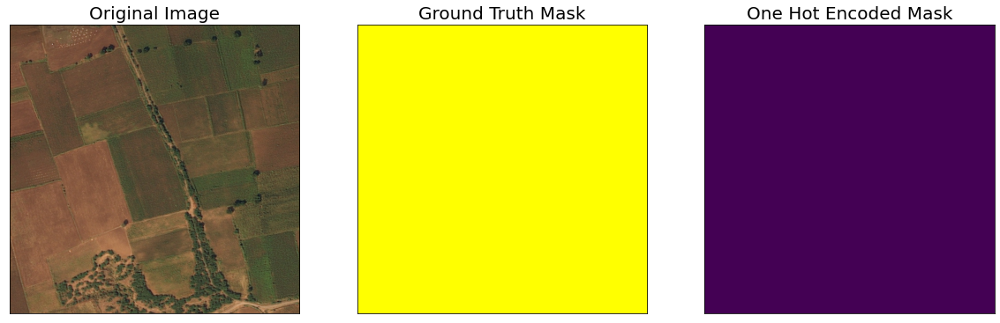

In [12]:
augmented_dataset = LandCoverDataset(
    train_df, 
    augmentation=get_training_augmentation(),
    class_rgb_values=select_class_rgb_values,
)

random_idx = random.randint(0, len(augmented_dataset)-1)

# Different augmentations on image/mask pairs
for idx in range(3):
    image, mask = augmented_dataset[idx]
    visualize(
        original_image = image,
        ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
        one_hot_encoded_mask = reverse_one_hot(mask)
    )

In [13]:
ENCODER = 'resnet50'
ENCODER_WEIGHTS = 'imagenet'
CLASSES = select_classes
ACTIVATION = 'sigmoid'

model = smp.DeepLabV3Plus(
    encoder_name=ENCODER, 
    encoder_weights=ENCODER_WEIGHTS, 
    classes=len(CLASSES), 
    activation=ACTIVATION,
)

preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)

Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/hub/checkpoints/resnet50-19c8e357.pth


#### Get Train / Val DataLoaders

In [14]:
train_dataset = LandCoverDataset(
    train_df, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=select_class_rgb_values,
)

valid_dataset = LandCoverDataset(
    valid_df, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=select_class_rgb_values,
)

# Get train and val data loaders
train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, num_workers=2)
valid_loader = DataLoader(valid_dataset, batch_size=1, shuffle=False, num_workers=4)

#### Set Hyperparams

In [15]:
TRAINING = True

EPOCHS = 5

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

loss = smp.utils.losses.DiceLoss()

metrics = [
    smp.utils.metrics.IoU(threshold=0.5),
]

optimizer = torch.optim.Adam([ 
    dict(params=model.parameters(), lr=0.00008),
])

lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(
    optimizer, T_0=1, T_mult=2, eta_min=5e-5,
)

if os.path.exists('../input/deepglobe-land-cover-classification-deeplabv3/best_model.pth'):
    model = torch.load('../input/deepglobe-land-cover-classification-deeplabv3/best_model.pth', map_location=DEVICE)
    print('Loaded pre-trained DeepLabV3+ model!')

In [16]:
train_epoch = smp.utils.train.TrainEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    optimizer=optimizer,
    device=DEVICE,
    verbose=True,
)

valid_epoch = smp.utils.train.ValidEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    device=DEVICE,
    verbose=True,
)

In [17]:
%%time

if TRAINING:

    best_iou_score = 0.0
    train_logs_list, valid_logs_list = [], []

    for i in range(0, EPOCHS):
        print('\nEpoch: {}'.format(i))
        train_logs = train_epoch.run(train_loader)
        valid_logs = valid_epoch.run(valid_loader)
        train_logs_list.append(train_logs)
        valid_logs_list.append(valid_logs)
        
        if best_iou_score < valid_logs['iou_score']:
            best_iou_score = valid_logs['iou_score']
            torch.save(model, './best_model.pth')
            print('Model saved!')


Epoch: 0
valid: 100%|██████████| 80/80 [00:49<00:00,  1.61it/s, dice_loss - 0.3903, iou_score - 0.6754]
Model saved!

Epoch: 1
valid: 100%|██████████| 80/80 [00:50<00:00,  1.60it/s, dice_loss - 0.2849, iou_score - 0.697]
Model saved!

Epoch: 2
valid: 100%|██████████| 80/80 [00:49<00:00,  1.61it/s, dice_loss - 0.2592, iou_score - 0.7044]
Model saved!

Epoch: 3
valid: 100%|██████████| 80/80 [00:49<00:00,  1.60it/s, dice_loss - 0.2246, iou_score - 0.7297]
Model saved!

Epoch: 4
valid: 100%|██████████| 80/80 [00:50<00:00,  1.57it/s, dice_loss - 0.2112, iou_score - 0.7295]
CPU times: user 25min 14s, sys: 24min 53s, total: 50min 7s
Wall time: 1h 1min 21s


### Prediction on Test Data

In [18]:
import os
import torch
if os.path.exists('./best_model.pth'):
    best_model = torch.load('./best_model.pth', map_location=DEVICE)

elif os.path.exists('../input/deepglobe-land-cover-classification-deeplabv3/best_model.pth'):
    best_model = torch.load('../input/deepglobe-land-cover-classification-deeplabv3/best_model.pth', map_location=DEVICE)


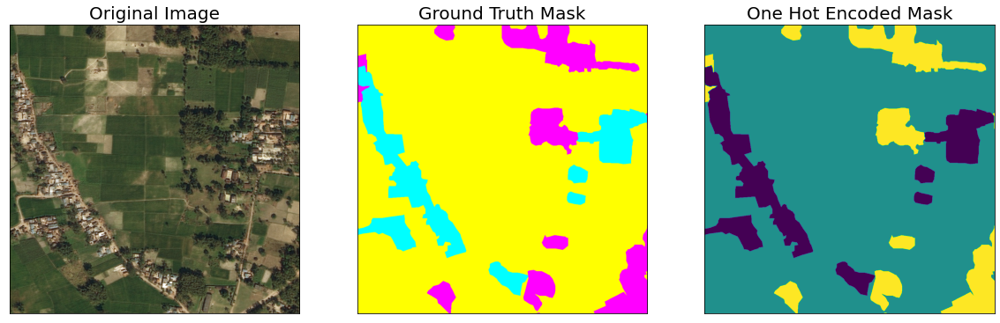

In [19]:

test_dataset = LandCoverDataset(
    valid_df, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=select_class_rgb_values,
)

test_dataloader = DataLoader(test_dataset)

test_dataset_vis = LandCoverDataset(
    valid_df,
    augmentation=get_validation_augmentation(),
    class_rgb_values=select_class_rgb_values,
)

random_idx = random.randint(0, len(test_dataset_vis)-1)
image, mask = test_dataset_vis[random_idx]

visualize(
    original_image = image,
    ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
    one_hot_encoded_mask = reverse_one_hot(mask)
)


In [20]:
sample_preds_folder = 'sample_predictions/'
if not os.path.exists(sample_preds_folder):
    os.makedirs(sample_preds_folder)

In [21]:
best_model = model

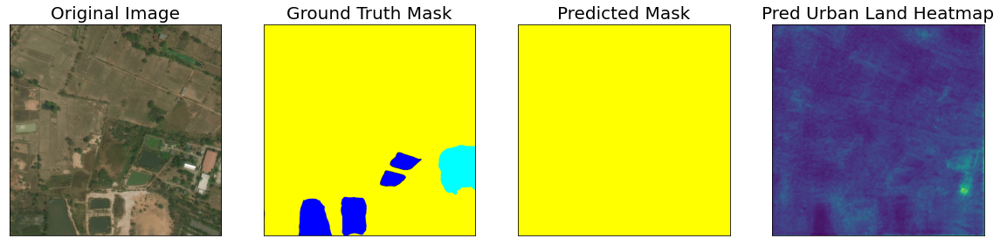

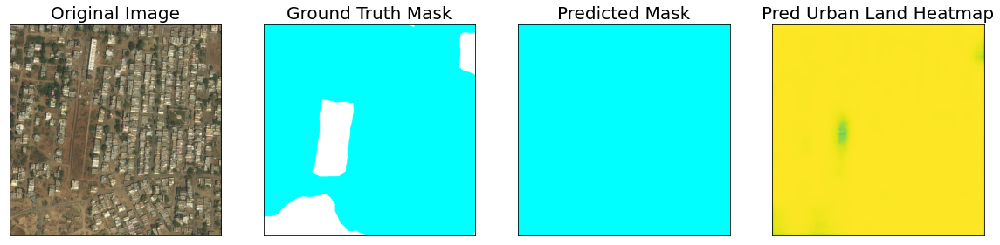

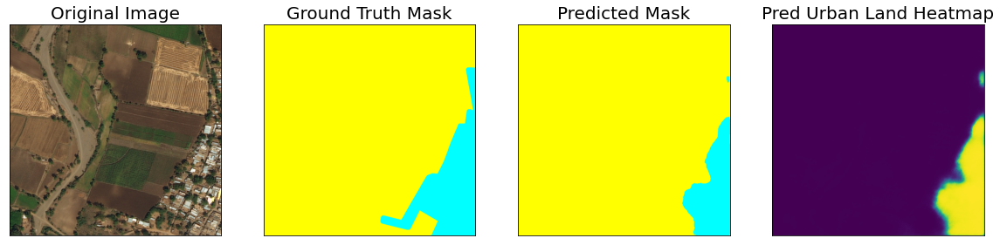

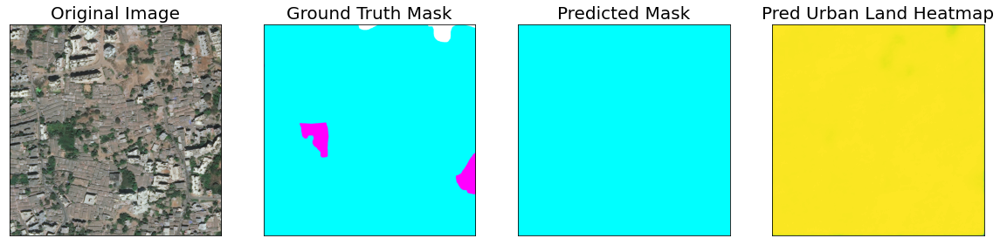

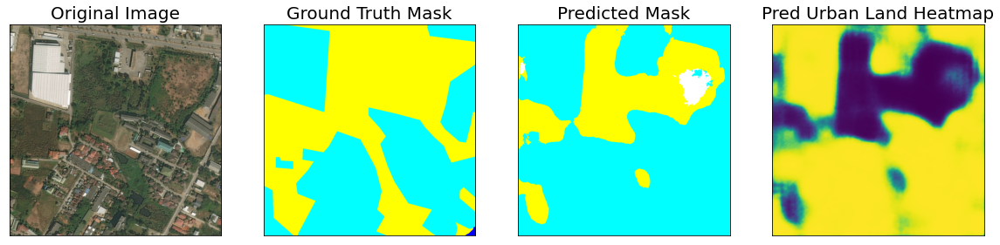

...

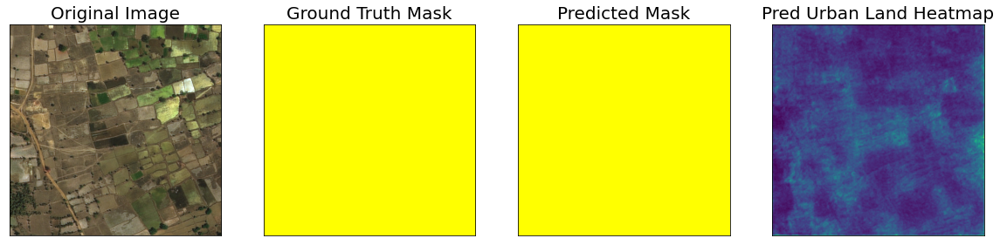

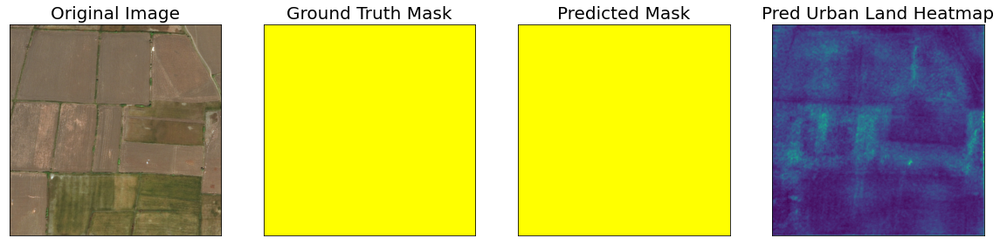

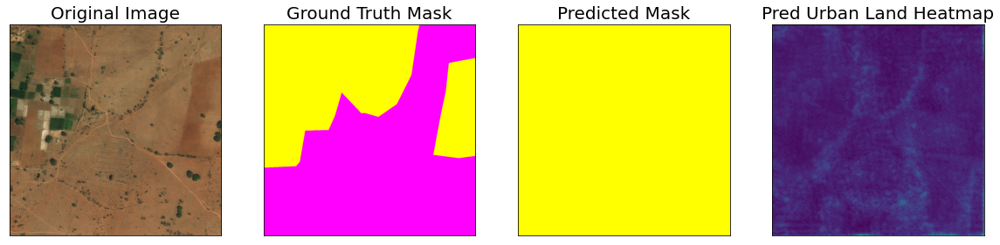

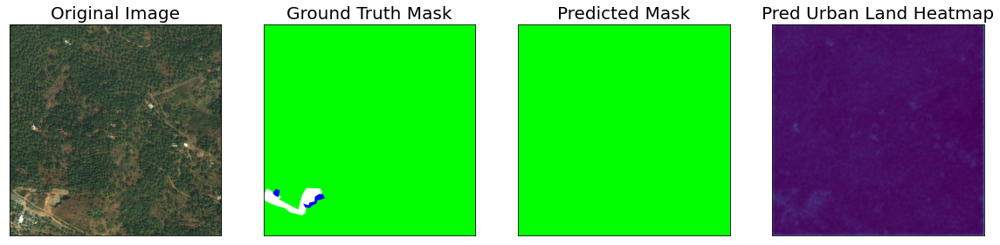

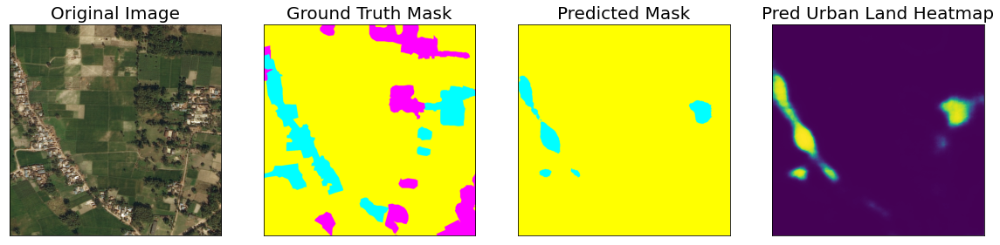

In [22]:
for idx in range(len(test_dataset)):

    image, gt_mask = test_dataset[idx]
    image_vis = test_dataset_vis[idx][0].astype('uint8')
    x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)
    pred_mask = best_model(x_tensor)
    pred_mask = pred_mask.detach().squeeze().cpu().numpy()
    pred_mask = np.transpose(pred_mask,(1,2,0))
    pred_urban_land_heatmap = pred_mask[:,:,select_classes.index('urban_land')]
    pred_mask = colour_code_segmentation(reverse_one_hot(pred_mask), select_class_rgb_values)
    gt_mask = np.transpose(gt_mask,(1,2,0))
    gt_mask = colour_code_segmentation(reverse_one_hot(gt_mask), select_class_rgb_values)
    cv2.imwrite(os.path.join(sample_preds_folder, f"sample_pred_{idx}.png"), np.hstack([image_vis, gt_mask, pred_mask])[:,:,::-1])
    
    visualize(
        original_image = image_vis,
        ground_truth_mask = gt_mask,
        predicted_mask = pred_mask,
        pred_urban_land_heatmap = pred_urban_land_heatmap
    )

### Model Evaluation on Test Dataset

In [23]:
test_epoch = smp.utils.train.ValidEpoch(
    model,
    loss=loss, 
    metrics=metrics, 
    device=DEVICE,
    verbose=True,
)

valid_logs = test_epoch.run(test_dataloader)
print("Evaluation on Test Data: ")
print(f"Mean IoU Score: {valid_logs['iou_score']:.4f}")
print(f"Mean Dice Loss: {valid_logs['dice_loss']:.4f}")

valid: 100%|██████████| 80/80 [01:50<00:00,  1.39s/it, dice_loss - 0.2112, iou_score - 0.7295]
Evaluation on Test Data: 
Mean IoU Score: 0.7295
Mean Dice Loss: 0.2112


### Plot Dice Loss & IoU Metric for Train vs. Val

In [24]:
train_logs_df = pd.DataFrame(train_logs_list)
valid_logs_df = pd.DataFrame(valid_logs_list)
train_logs_df.T

,0,1,2,3,4
dice_loss,0.632403,0.463411,0.360099,0.308990,0.288635
iou_score,0.365130,0.520509,0.585144,0.622675,0.624745


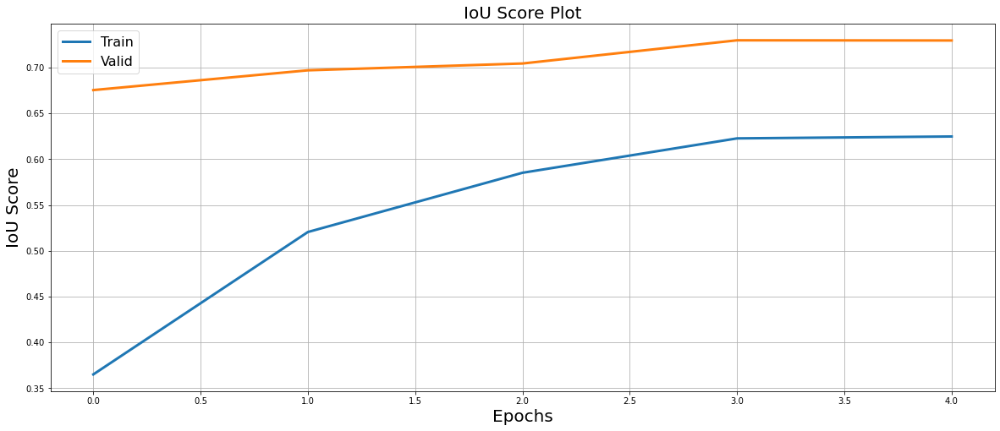

In [25]:
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.iou_score.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.iou_score.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('IoU Score', fontsize=20)
plt.title('IoU Score Plot', fontsize=20)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('iou_score_plot.png')
plt.show()

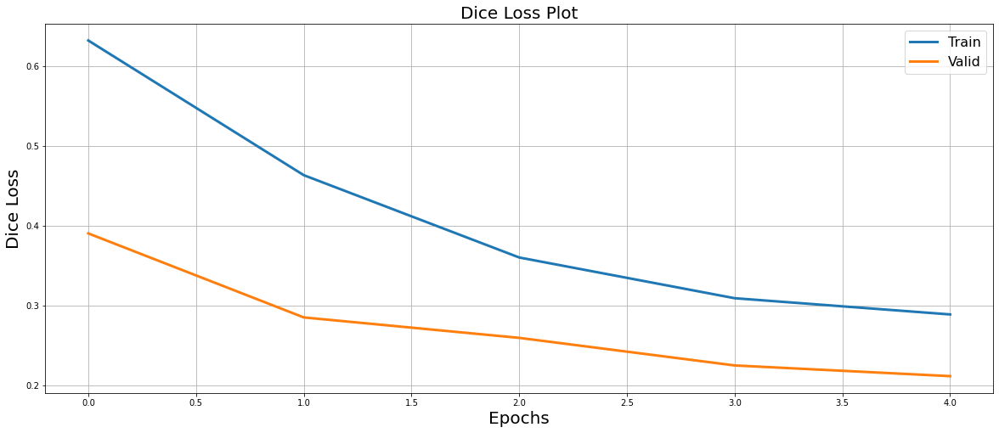

In [26]:
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.dice_loss.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.dice_loss.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('Dice Loss', fontsize=20)
plt.title('Dice Loss Plot', fontsize=20)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('dice_loss_plot.png')
plt.show()

In [27]:
import cv2

predicted_image = cv2.imread('/kaggle/input/deepglobe-land-cover-classification-dataset/train/100694_mask.png', cv2.IMREAD_GRAYSCALE)

# Threshold the predicted image to obtain a binary mask
_, binary_mask = cv2.threshold(predicted_image,127, 255, cv2.THRESH_BINARY)

# Calculate the area of the segmented region
area = cv2.countNonZero(binary_mask)

print("Area of the segmented region:", area)

Area of the segmented region: 5747668


In [28]:
# import cv2
# import numpy as np

# # Load the segmented image
# segmented_image = cv2.imread('/kaggle/input/deepglobe-land-cover-classification-dataset/train/10901_mask.png')
# x,y,z = segmented_image.shape

# # Define the RGB values for each class
# class_rgb_values = [
#     [0, 255, 255],  # Class 1 (Example: Yellow)
#     [255, 255, 0],  # Class 2 (Example: Cyan)
#     [255, 0, 255],  # Class 3 (Example: Magenta)
#     [0, 255, 0],    # Class 4 (Example: Green)
#     [0, 0, 255],    # Class 5 (Example: Red)
#     [255, 255, 255],# Class 6 (Example: White)
#     [0, 0, 0]       # Class 7 (Example: Black)
# ]

# # Convert the segmented image to grayscale for easier comparison
# gray_segmented_image = cv2.cvtColor(segmented_image, cv2.COLOR_BGR2GRAY)
# x,y = gray_segmented_image.shape
# total_area = x*y
# print(total_area)

# # Initialize a dictionary to store the area of each class
# class_areas = {}

# # Iterate over each class RGB value
# for idx, rgb_value in enumerate(class_rgb_values, start=1):
#     # Create a binary mask for the current class
#     class_mask = cv2.inRange(segmented_image, np.array(rgb_value), np.array(rgb_value))

#     # Count the non-zero pixels in the mask to calculate the area of the segmented region for the current class
#     area = cv2.countNonZero(class_mask)

#     # Store the area in the dictionary
#     class_areas[f'Class {idx}'] = area

# # Print the area of each class
# for class_name, area in class_areas.items():
#     print(f"Area of segmented region for {class_name}: {(area/total_area)*100}")


In [29]:
import cv2
import numpy as np

# Load the segmented image
segmented_image = cv2.imread('/kaggle/input/deepglobe-land-cover-classification-dataset/train/174980_mask.png')

# Define the class names
class_names = ['urban_land', 'agriculture_land', 'rangeland', 'forest_land', 'water', 'barren_land', 'unknown']

# Define the RGB values for each class
class_rgb_values = [
    [0, 255, 255],  # urban_land (Yellow)
    [255, 255, 0],  # agriculture_land (Cyan)
    [255, 0, 255],  # rangeland (Magenta)
    [0, 255, 0],    # forest_land (Green)
    [0, 0, 255],    # water (Red)
    [255, 255, 255],# barren_land (White)
    [0, 0, 0]       # unknown (Black)
]

# Convert the segmented image to grayscale for easier comparison
gray_segmented_image = cv2.cvtColor(segmented_image, cv2.COLOR_BGR2GRAY)

# Calculate the total area of the image
total_area = gray_segmented_image.shape[0] * gray_segmented_image.shape[1]

# Initialize a dictionary to store the area of each class
class_areas = {}

# Iterate over each class RGB value
for class_name, rgb_value in zip(class_names, class_rgb_values):
    # Create a binary mask for the current class
    class_mask = cv2.inRange(segmented_image, np.array(rgb_value), np.array(rgb_value))

    # Count the non-zero pixels in the mask to calculate the area of the segmented region for the current class
    area = cv2.countNonZero(class_mask)

    # Store the area in the dictionary
    class_areas[class_name] = area

# Print the area of each class as a percentage of the total image area
for class_name, area in class_areas.items():
    print(f"Area of segmented region for {class_name}: {(area / total_area) * 100}%")


Area of segmented region for urban_land: 1.1322768486479557%
Area of segmented region for agriculture_land: 0.0%
Area of segmented region for rangeland: 2.6345869911145283%
Area of segmented region for forest_land: 95.12145101777094%
Area of segmented region for water: 0.0%
Area of segmented region for barren_land: 1.1116851424665726%
Area of segmented region for unknown: 0.0%
